## Set up

#### Import Libraries

In [8]:
from utils import *

In [9]:
# TO DO: check if lines 8-11 are needed 

RANDOM_SEED = 6
np.random.seed(RANDOM_SEED)

# torch.backends.cudnn.benchmark = False # uses deterministic convolution algorithm (may reduce performance)
# torch.backends.cudnn.deterministic = True #

#Sets the seed of RNG (GPU and CPU)
torch.manual_seed(RANDOM_SEED)
random.seed(RANDOM_SEED)

torch.cuda.manual_seed_all(RANDOM_SEED)
torch.cuda.manual_seed(RANDOM_SEED) 

In [10]:
# Set settings
features, input_window, output_window, stride = set_settings()

print(f'features: {features}')
print(f'input_window: {input_window}')
print(f'output_window: {output_window}')
print(f'stride: {stride}')

features: ['Hips Flexion-Extension Left', 'Knees Flexion-Extension Left', 'Ankles Dorsiflexion-Plantarflexion Left', 'Hips Flexion-Extension Right', 'Knees Flexion-Extension Right', 'Ankles Dorsiflexion-Plantarflexion Right']
input_window: 100
output_window: 1
stride: 1


In [11]:
# Set device
print(f'The device used in this notebook is: {setDevice()}')

DEVICE = setDevice()

The device used in this notebook is: cuda


#### Load Data 

In [12]:
file_dir = r'D:\Study 2 Data\Healthy Gait\Train'
train_files = os.listdir(file_dir) 

# Changes the working directory to get the data from their location 
os.chdir(file_dir)
cwd = os.getcwd()

print(f'Current working directory is: {cwd}')
print(f"There are {len(train_files)} files in the specified path.")

Current working directory is: D:\Study 2 Data\Healthy Gait\Train
There are 7 files in the specified path.


In [13]:
train_files

['AB3154 BF T6-10.csv',
 'AB6751 BF T1-5.csv',
 'AB7422 BF T1-5.csv',
 'AB7779 BF T1-5.csv',
 'AB9119 BF T1-5.csv',
 'AB9737 BF T1-5.csv',
 'AB9737 BF T6-10.csv']

In [14]:
#Create feature list to extract values needed from CSV files
# features = ['Hips Flexion-Extension Left',
#                 'Hips Abduction-Adduction Left',
#                 'Hips Rotation Left',
#                 'Knees Flexion-Extension Left',
#                 'Knees Abduction-Adduction Left',
#                 'Knees Rotation Left',
#                 'Ankles Dorsiflexion-Plantarflexion Left',
#                 'Ankles Eversion-Inversion Left',
#                 'Ankles Rotation Left', 
#                 'Hips Flexion-Extension Right',
#                 'Hips Abduction-Adduction Right',
#                 'Hips Rotation Right',
#                 'Knees Flexion-Extension Right',
#                 'Knees Abduction-Adduction Right',
#                 'Knees Rotation Right',
#                 'Ankles Dorsiflexion-Plantarflexion Right',
#                 'Ankles Eversion-Inversion Right',
#                 'Ankles Rotation Right']

all_features = ['Trial', 
                'Time'] + features
                
all_features

['Trial',
 'Time',
 'Hips Flexion-Extension Left',
 'Knees Flexion-Extension Left',
 'Ankles Dorsiflexion-Plantarflexion Left',
 'Hips Flexion-Extension Right',
 'Knees Flexion-Extension Right',
 'Ankles Dorsiflexion-Plantarflexion Right']

#### Extract Data from CSV into Pandas Dataframe

In [15]:
all_data = create_dataframe(train_files, all_features)

Extracting data from: AB3154 BF T6-10.csv
Extracting data from: AB6751 BF T1-5.csv
Extracting data from: AB7422 BF T1-5.csv
Extracting data from: AB7779 BF T1-5.csv
Extracting data from: AB9119 BF T1-5.csv
Extracting data from: AB9737 BF T1-5.csv
Extracting data from: AB9737 BF T6-10.csv


In [16]:
all_data.reset_index(drop=True, inplace=True)
all_data

,Patient ID,Trial,Time,Hips Flexion-Extension Left,Knees Flexion-Extension Left,Ankles Dorsiflexion-Plantarflexion Left,Hips Flexion-Extension Right,Knees Flexion-Extension Right,Ankles Dorsiflexion-Plantarflexion Right
0,AB3154 BF T6-10,1,161.00,-1.76414,0.42597,2.24148,-1.29770,4.85581,4.25152
1,AB3154 BF T6-10,1,161.01,-1.71541,0.43044,2.25861,-1.13917,4.97912,4.25320
2,AB3154 BF T6-10,1,161.02,-1.66432,0.43358,2.27493,-0.96327,5.11719,4.25485
3,AB3154 BF T6-10,1,161.03,-1.60888,0.43609,2.29088,-0.77092,5.26771,4.25494
4,AB3154 BF T6-10,1,161.04,-1.54643,0.43905,2.30714,-0.56356,5.42747,4.25163
...,...,...,...,...,...,...,...,...,...
69453,AB9737 BF T6-10,14,474.70,5.59699,13.43638,-0.19627,-10.90823,6.82313,14.37402
69454,AB9737 BF T6-10,14,474.71,5.45820,13.20250,-0.17039,-10.20259,7.80148,14.11679
69455,AB9737 BF T6-10,14,474.72,5.31928,12.95930,-0.15604,-9.44410,8.89409,13.85472
69456,AB9737 BF T6-10,14,474.73,5.17878,12.70795,-0.15333,-8.64847,10.08021,13.59274


In [17]:
n_trials = all_data['Trial'].max()
print(f'maximum number of trials is: {n_trials}')

maximum number of trials is: 16


In [64]:
all_hlthy_subjects = all_data['Patient ID'].unique()
all_hlthy_subjects

array(['AB3154 BF T6-10', 'AB6751 BF T1-5', 'AB7422 BF T1-5',
       'AB7779 BF T1-5', 'AB9119 BF T1-5', 'AB9737 BF T1-5',
       'AB9737 BF T6-10'], dtype=object)

#### Plot Trials

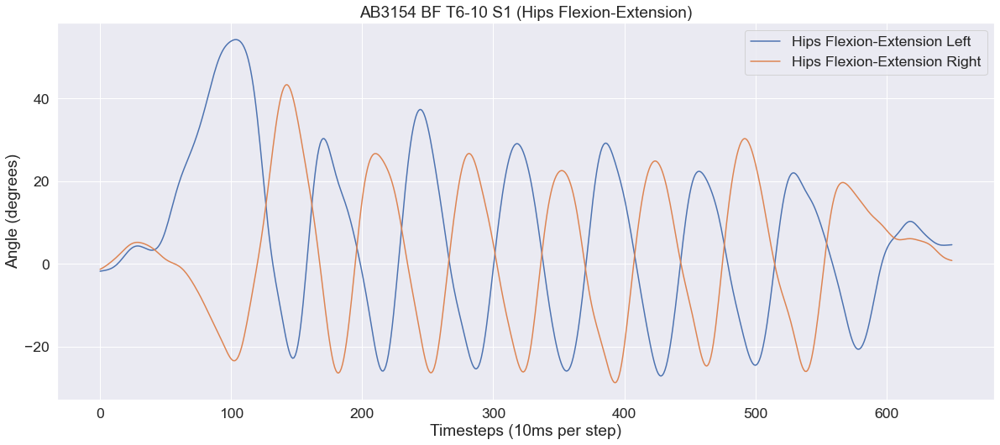

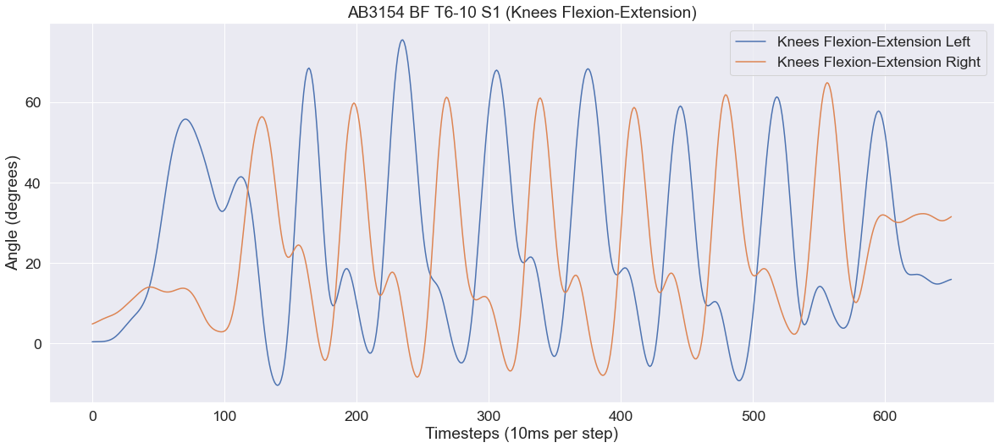

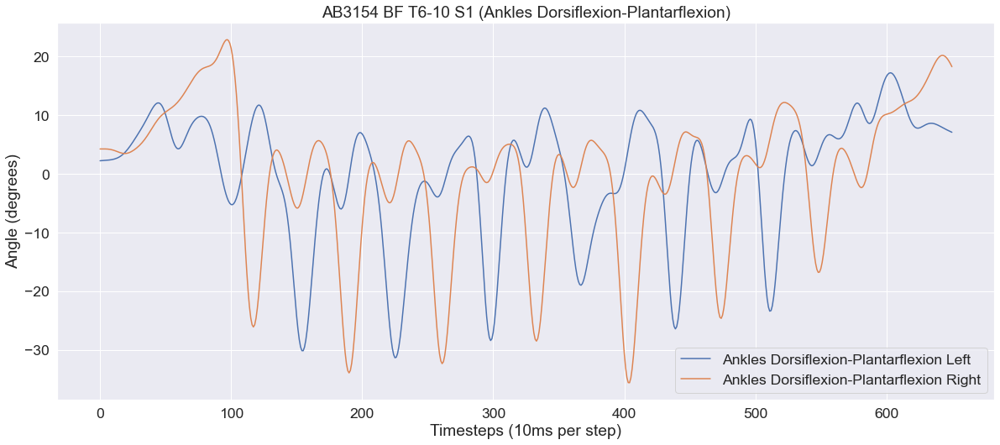

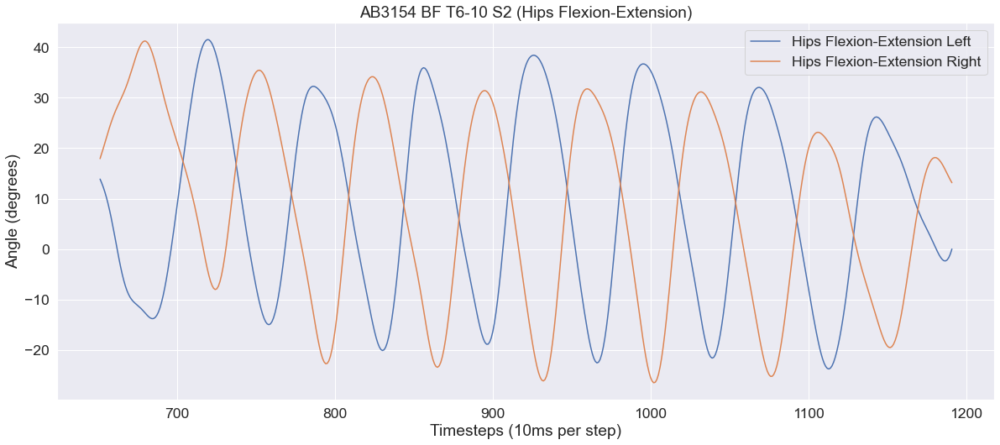

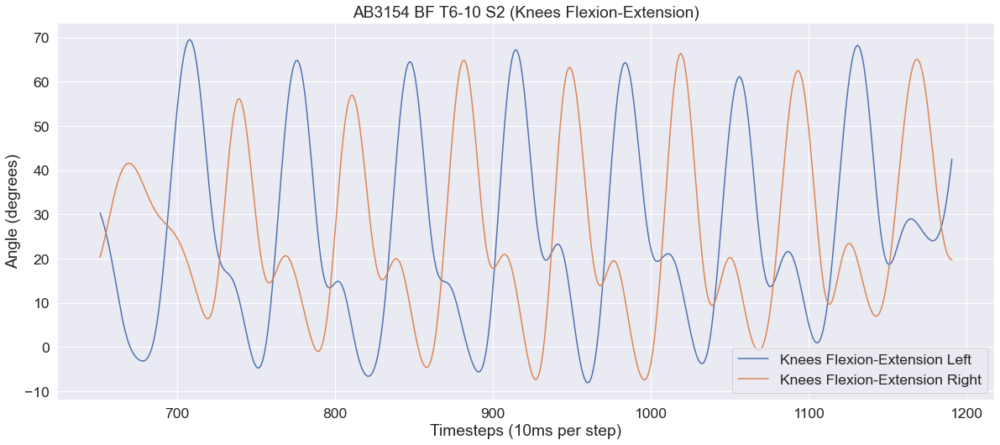

...

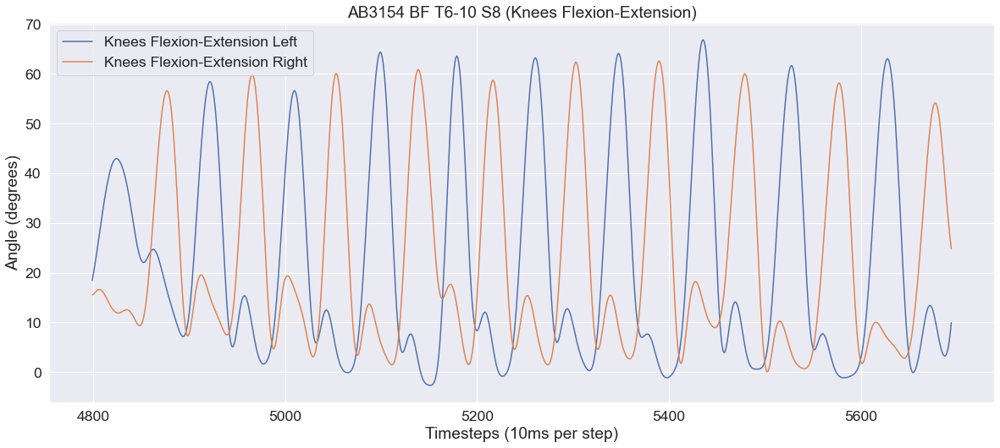

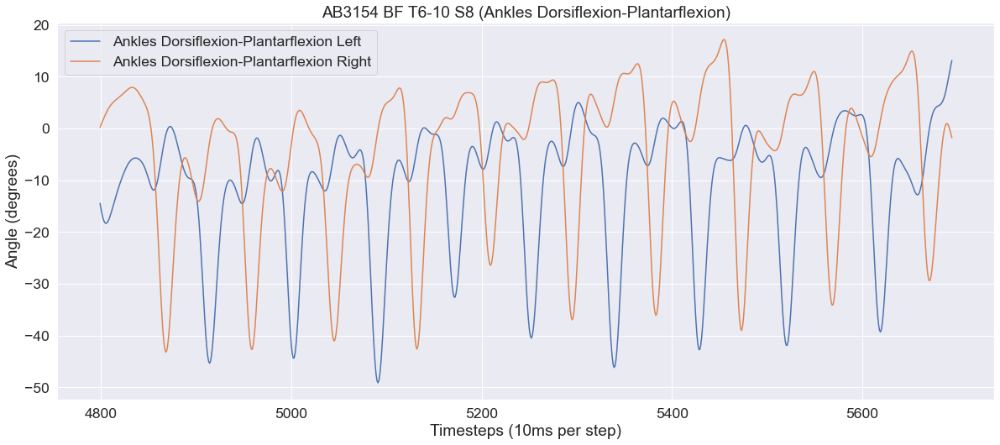

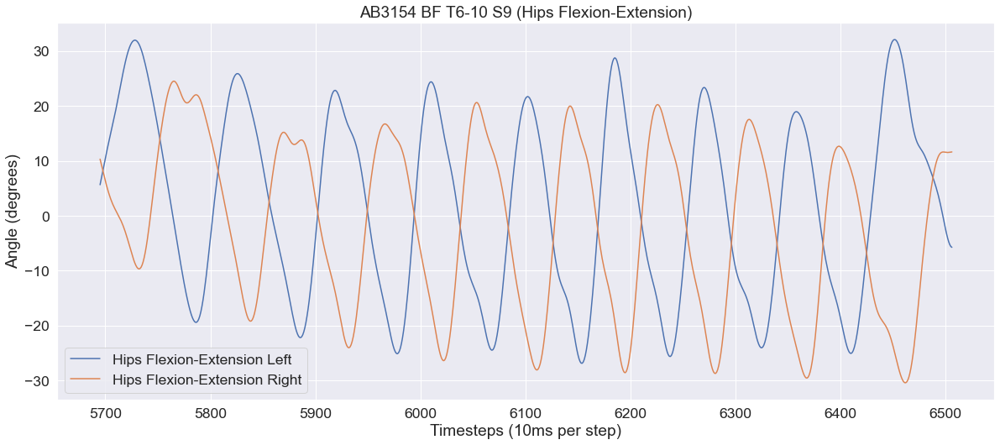

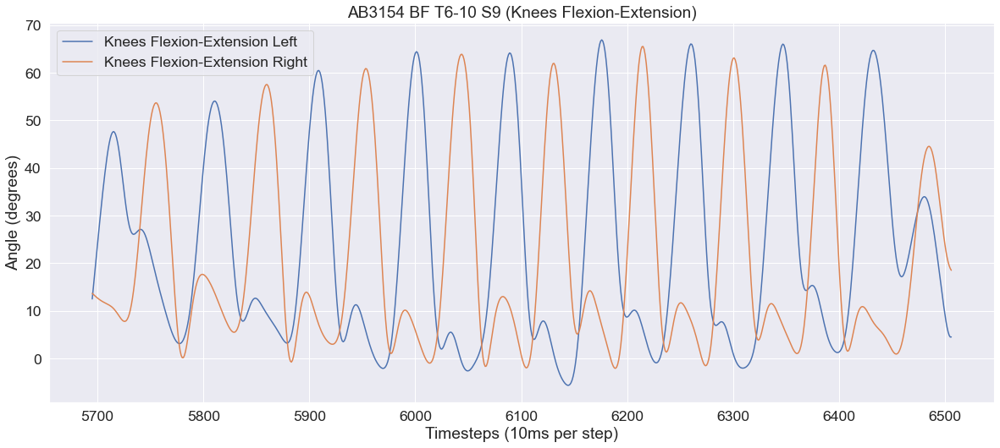

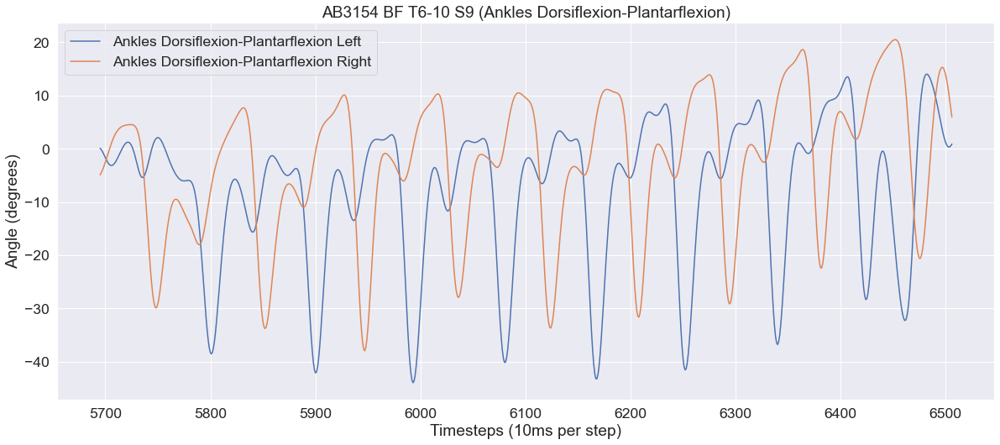

Timeseries is empty!
Trail 10 does not exist in AB3154 BF T6-10
Timeseries is empty!
Trail 11 does not exist in AB3154 BF T6-10
Timeseries is empty!
Trail 12 does not exist in AB3154 BF T6-10
Timeseries is empty!
Trail 13 does not exist in AB3154 BF T6-10
Timeseries is empty!
Trail 14 does not exist in AB3154 BF T6-10
Timeseries is empty!
Trail 15 does not exist in AB3154 BF T6-10
Timeseries is empty!
Trail 16 does not exist in AB3154 BF T6-10


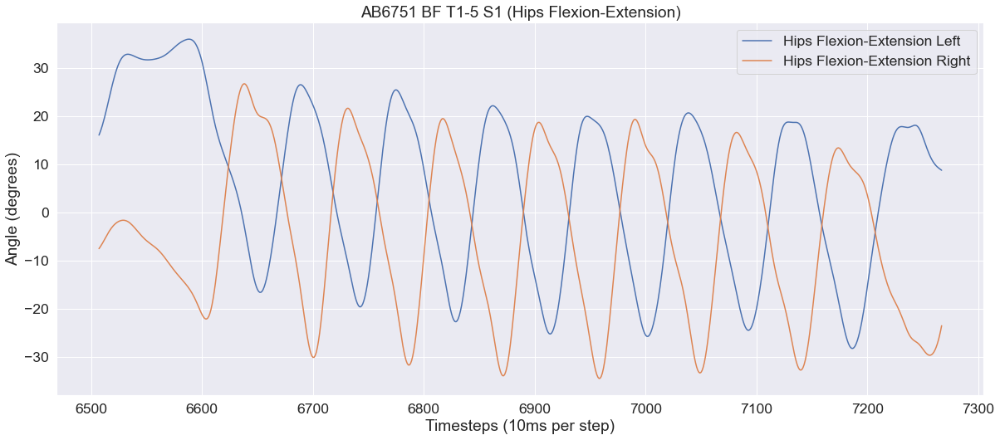

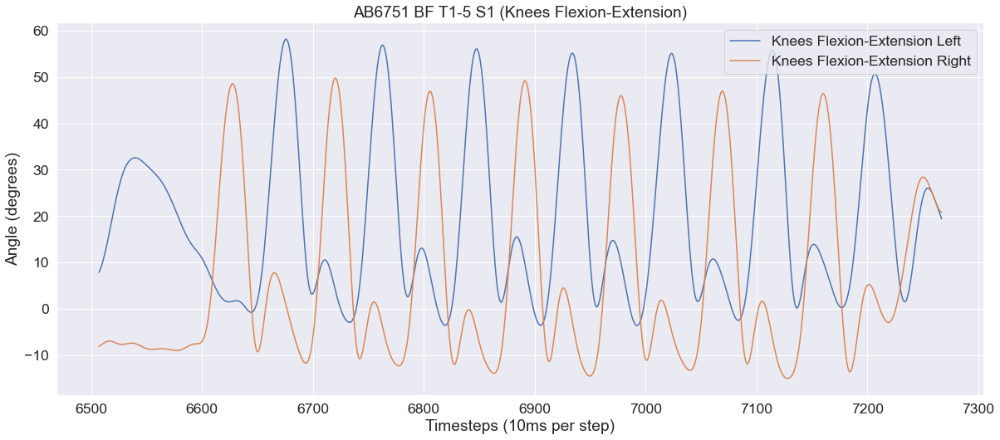

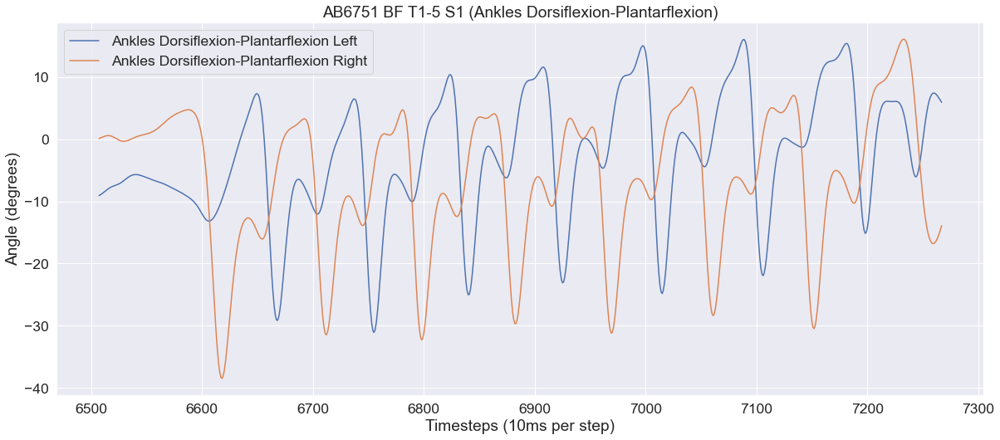

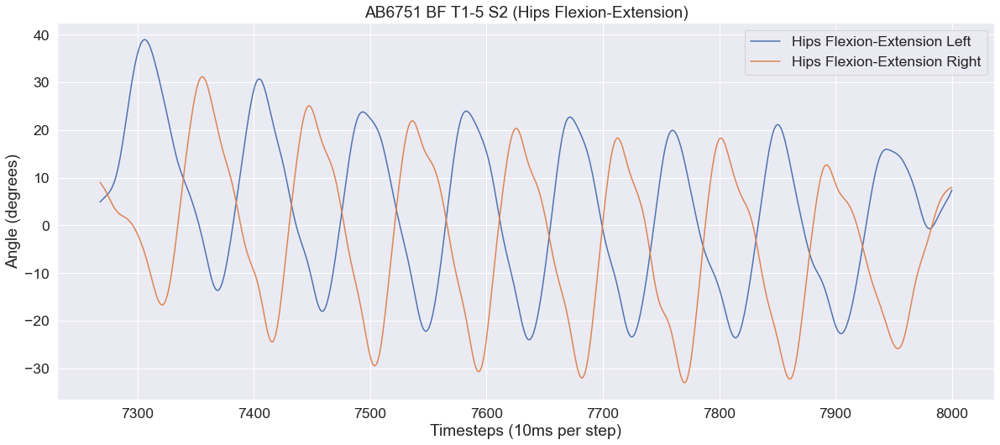

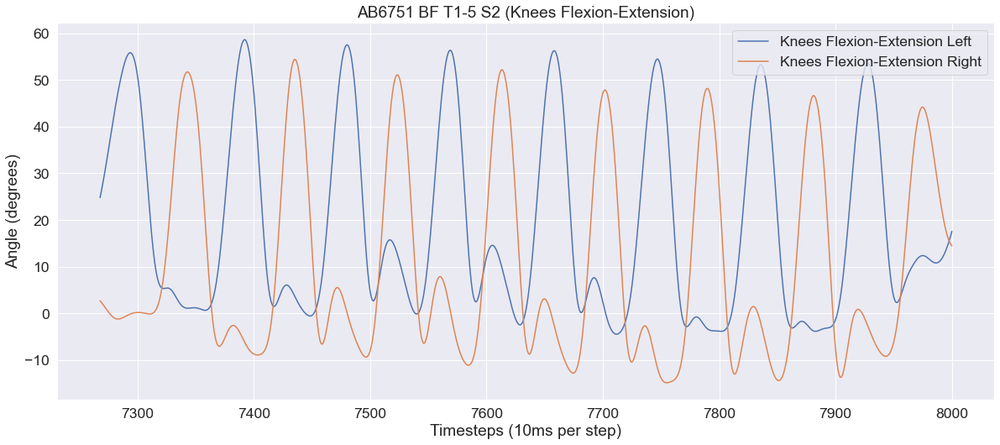

...

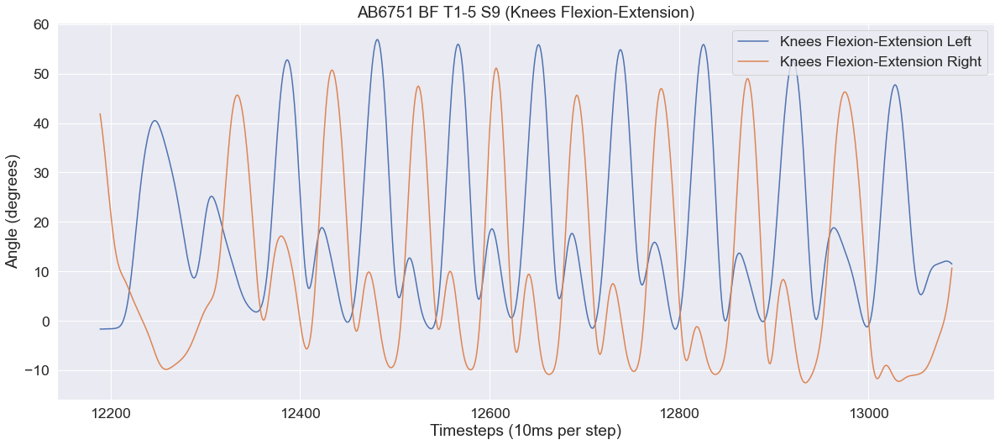

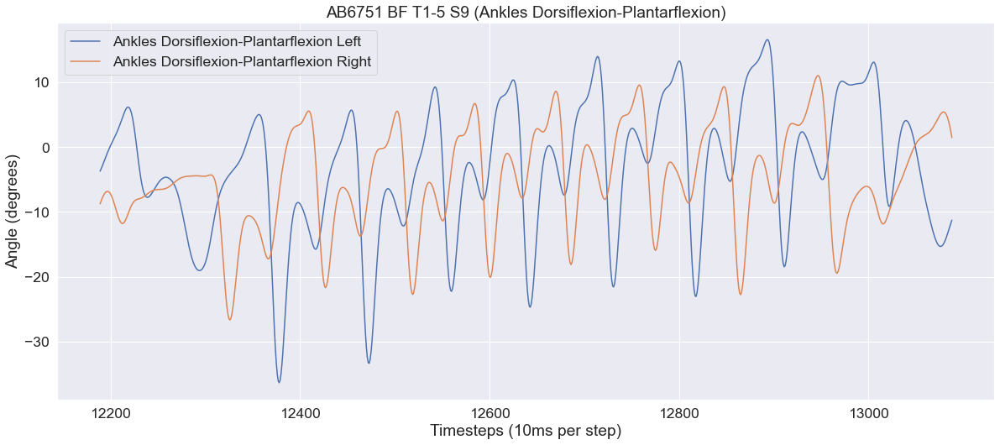

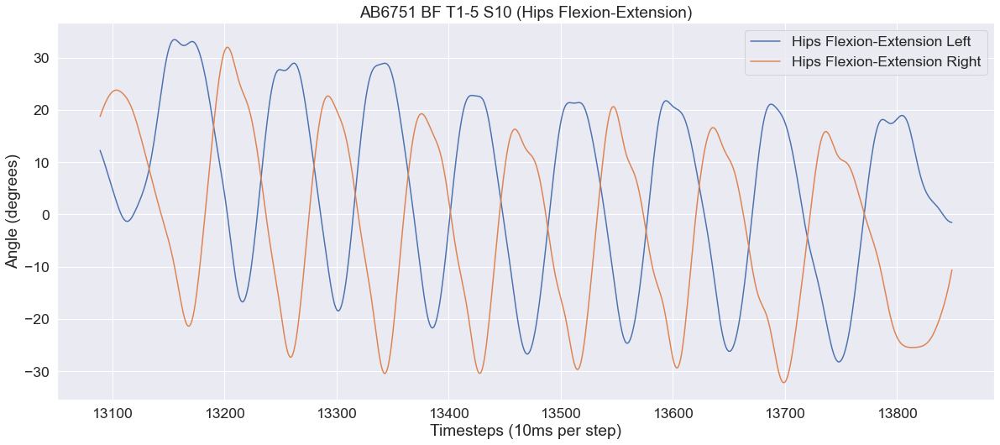

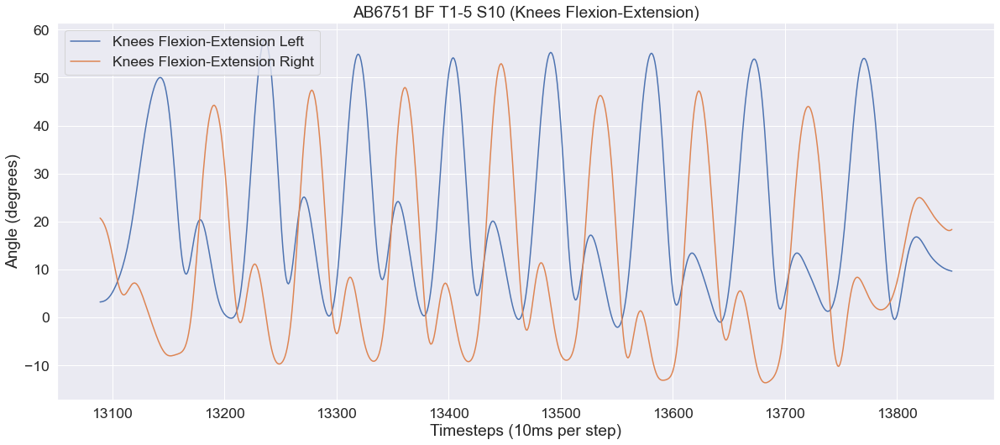

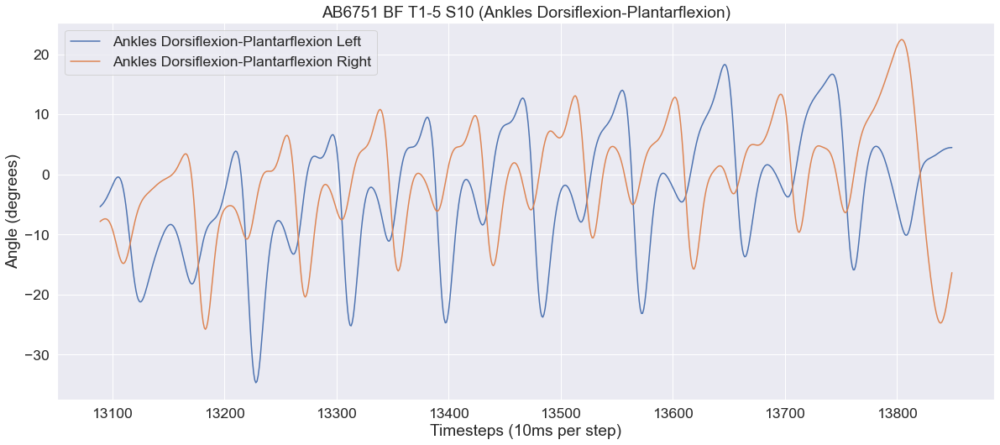

Timeseries is empty!
Trail 11 does not exist in AB6751 BF T1-5
Timeseries is empty!
Trail 12 does not exist in AB6751 BF T1-5
Timeseries is empty!
Trail 13 does not exist in AB6751 BF T1-5
Timeseries is empty!
Trail 14 does not exist in AB6751 BF T1-5
Timeseries is empty!
Trail 15 does not exist in AB6751 BF T1-5
Timeseries is empty!
Trail 16 does not exist in AB6751 BF T1-5


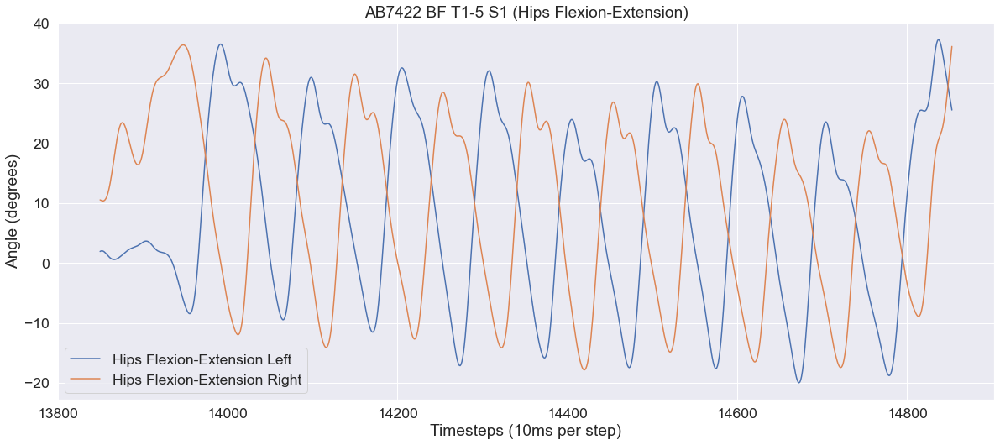

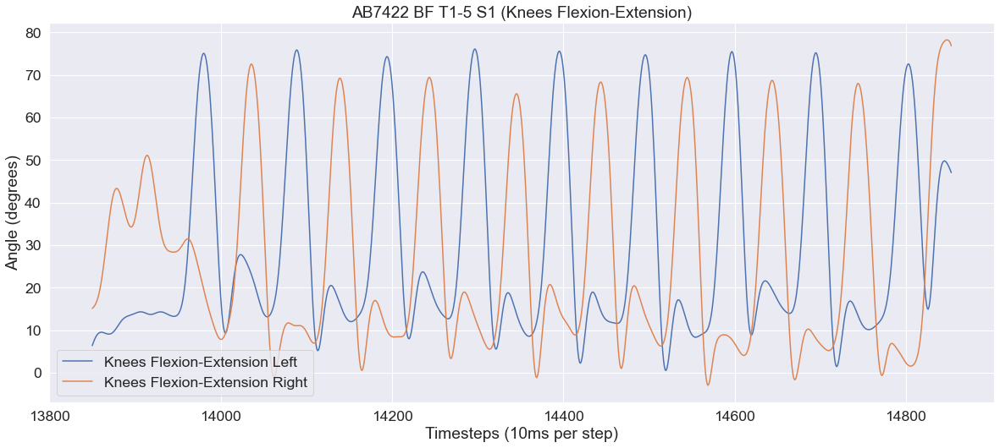

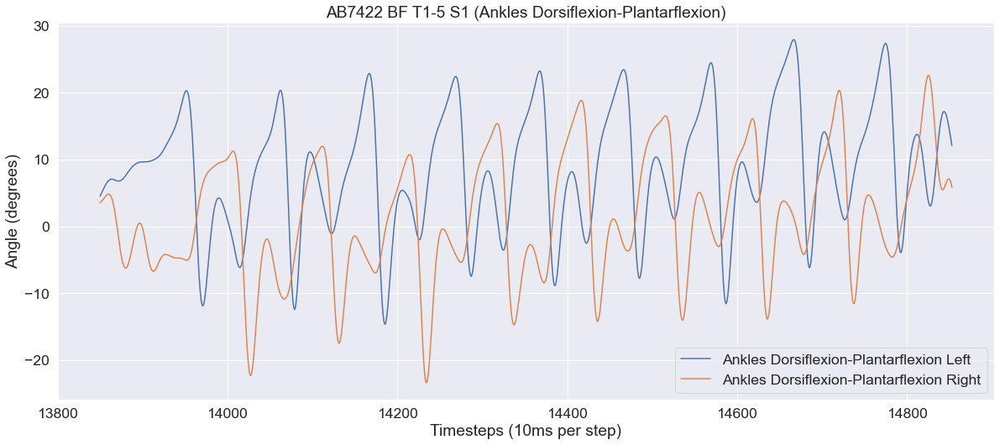

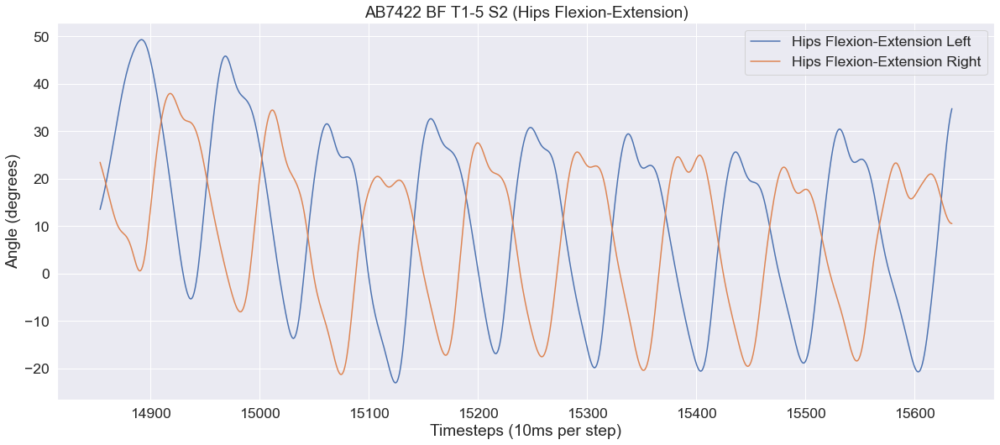

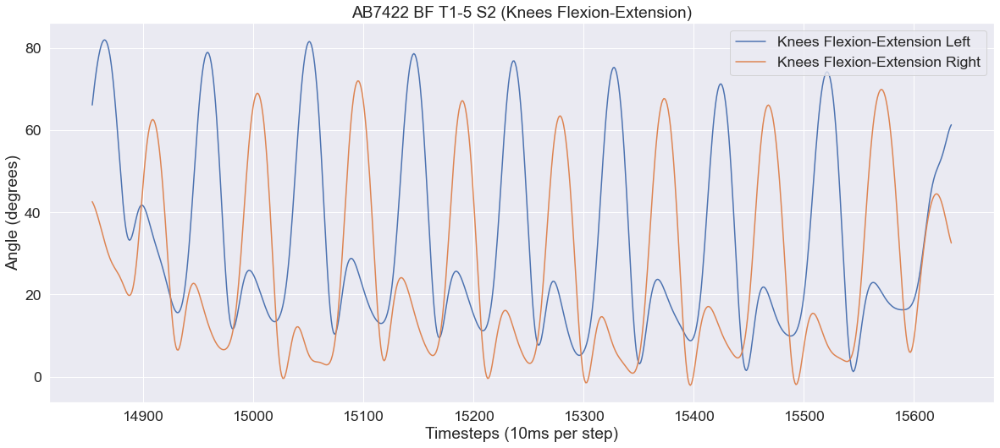

...

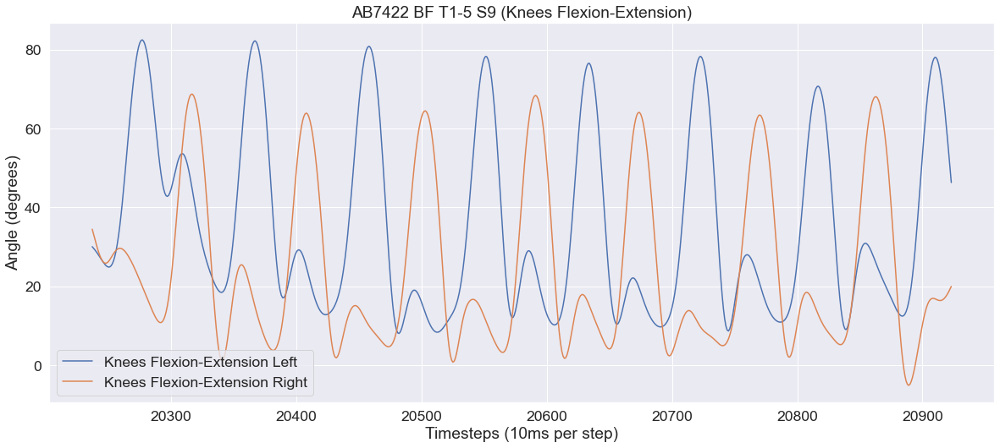

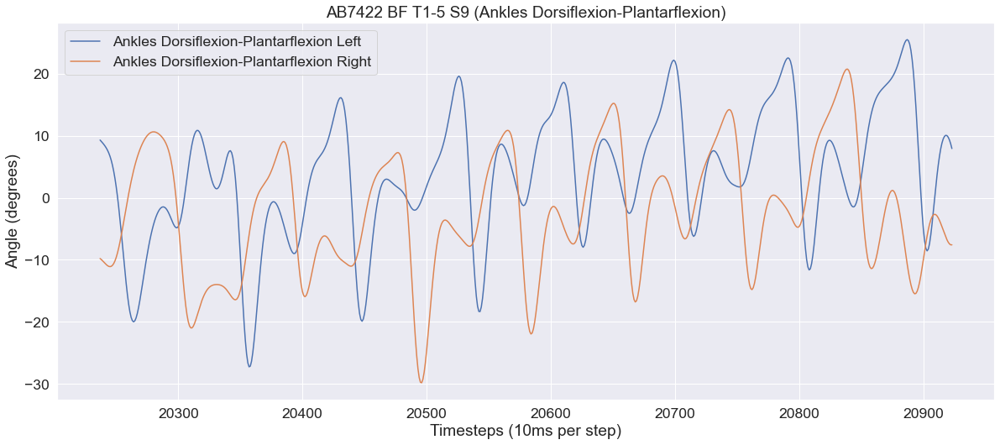

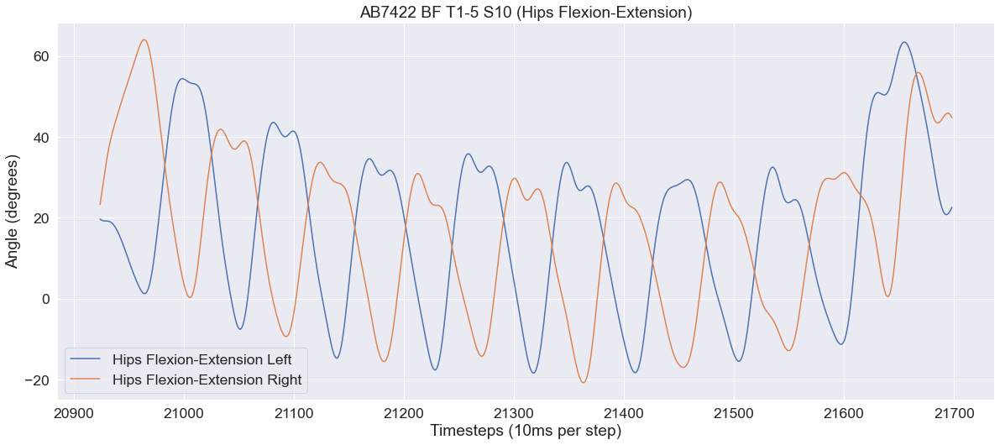

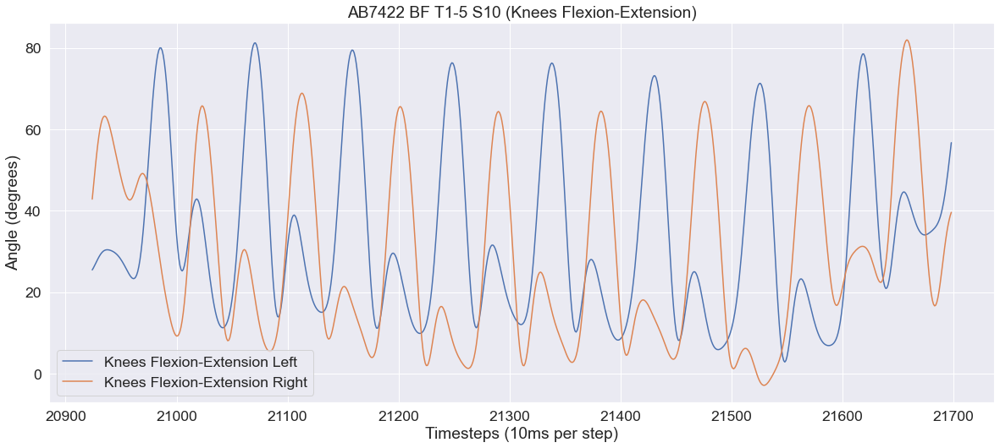

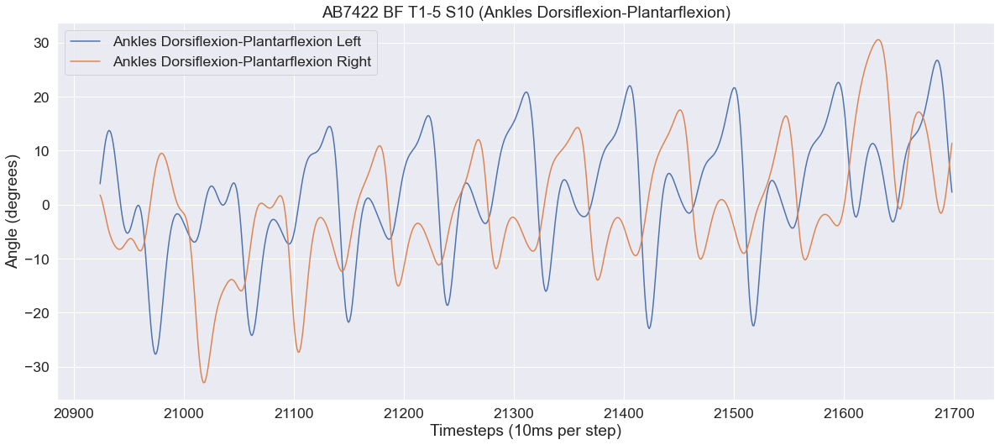

Timeseries is empty!
Trail 11 does not exist in AB7422 BF T1-5
Timeseries is empty!
Trail 12 does not exist in AB7422 BF T1-5
Timeseries is empty!
Trail 13 does not exist in AB7422 BF T1-5
Timeseries is empty!
Trail 14 does not exist in AB7422 BF T1-5
Timeseries is empty!
Trail 15 does not exist in AB7422 BF T1-5
Timeseries is empty!
Trail 16 does not exist in AB7422 BF T1-5


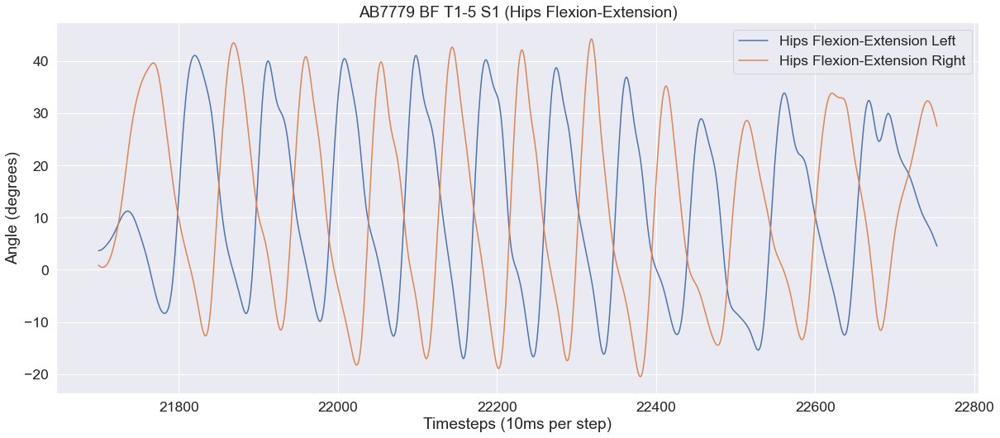

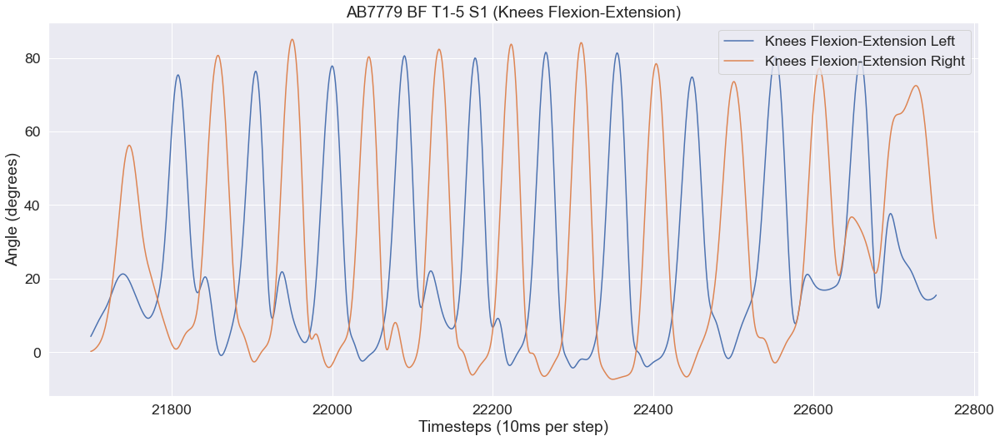

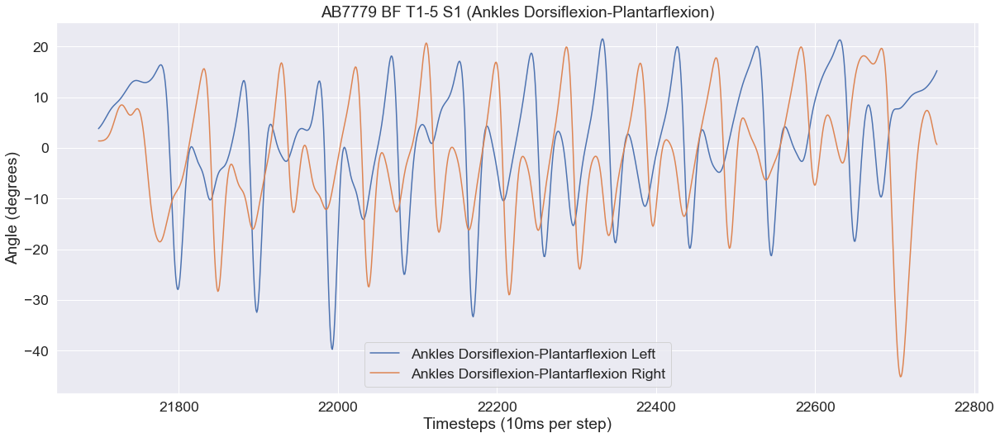

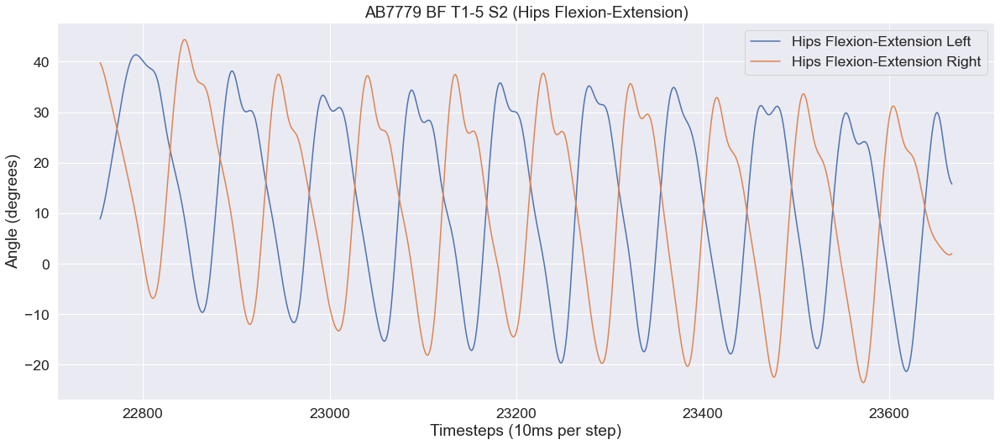

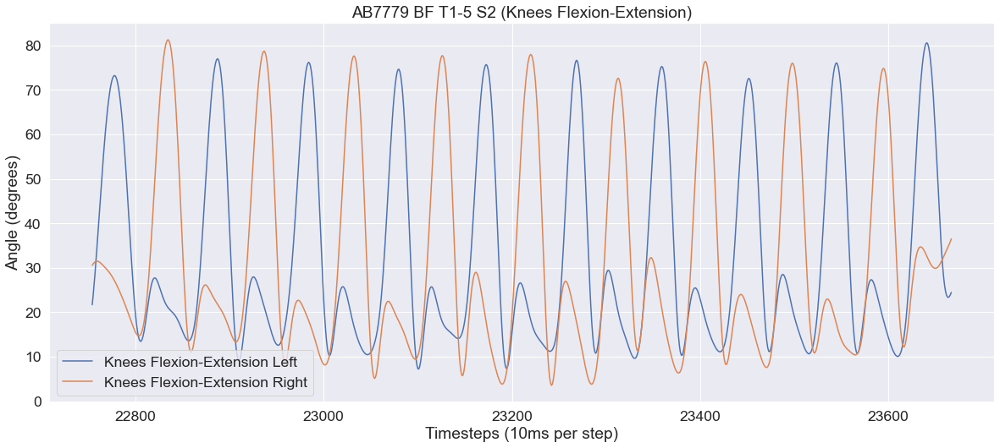

...

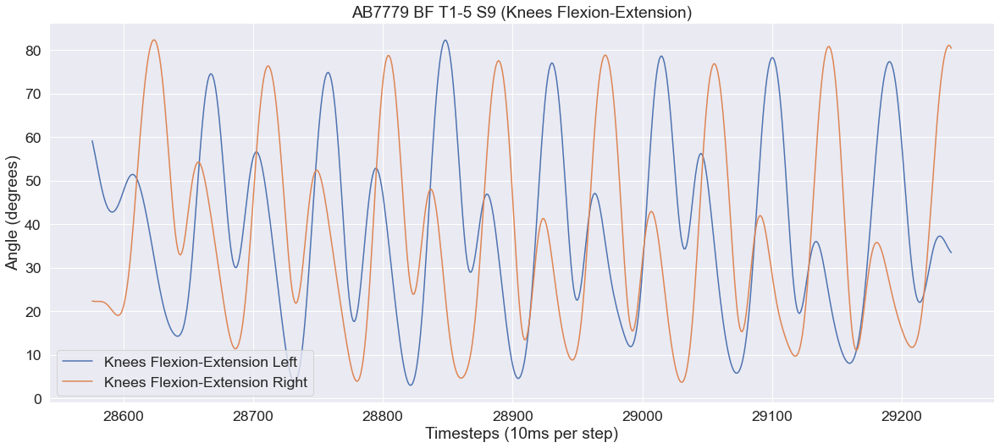

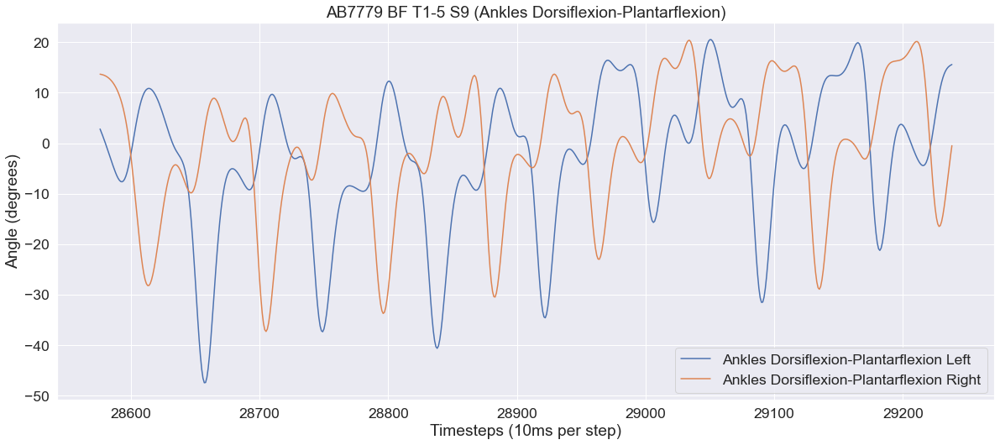

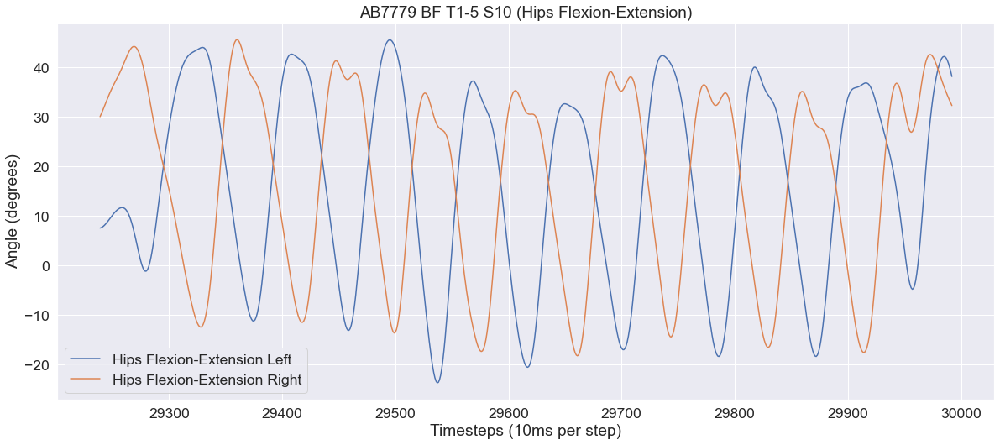

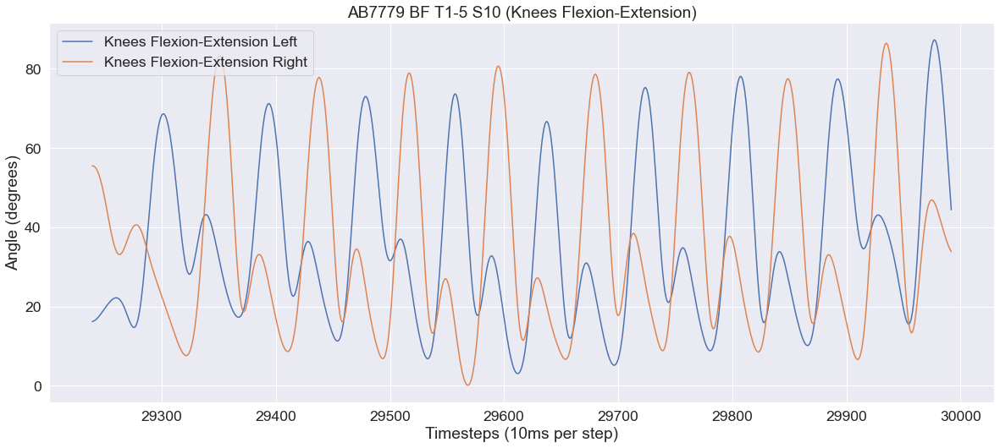

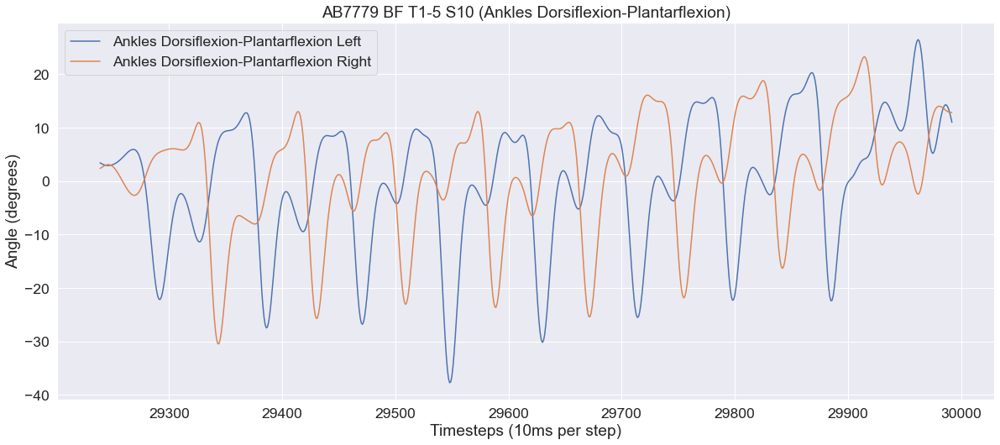

Timeseries is empty!
Trail 11 does not exist in AB7779 BF T1-5
Timeseries is empty!
Trail 12 does not exist in AB7779 BF T1-5
Timeseries is empty!
Trail 13 does not exist in AB7779 BF T1-5
Timeseries is empty!
Trail 14 does not exist in AB7779 BF T1-5
Timeseries is empty!
Trail 15 does not exist in AB7779 BF T1-5
Timeseries is empty!
Trail 16 does not exist in AB7779 BF T1-5


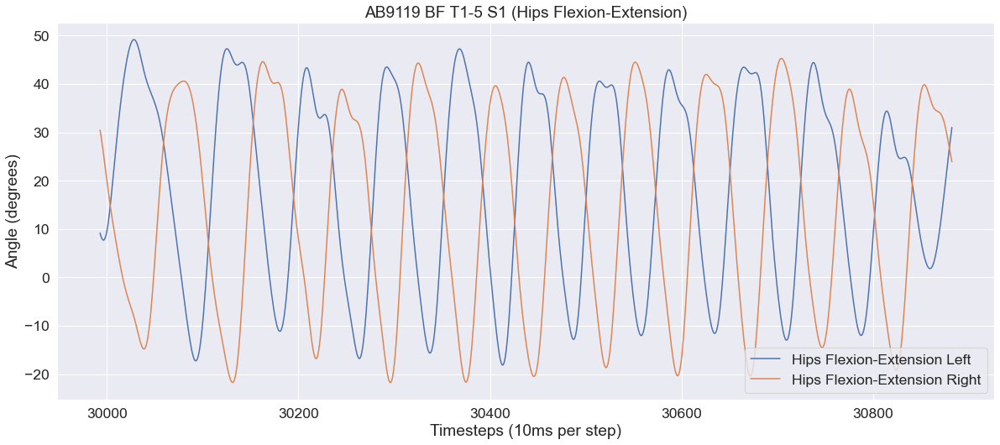

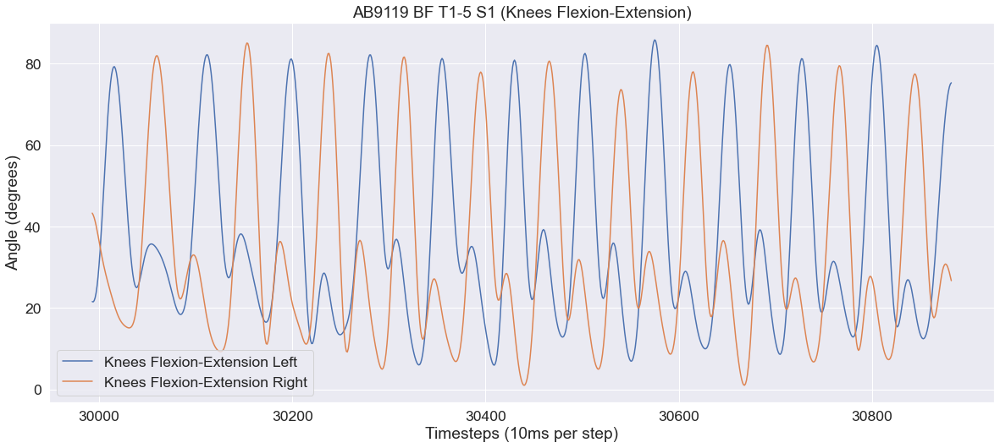

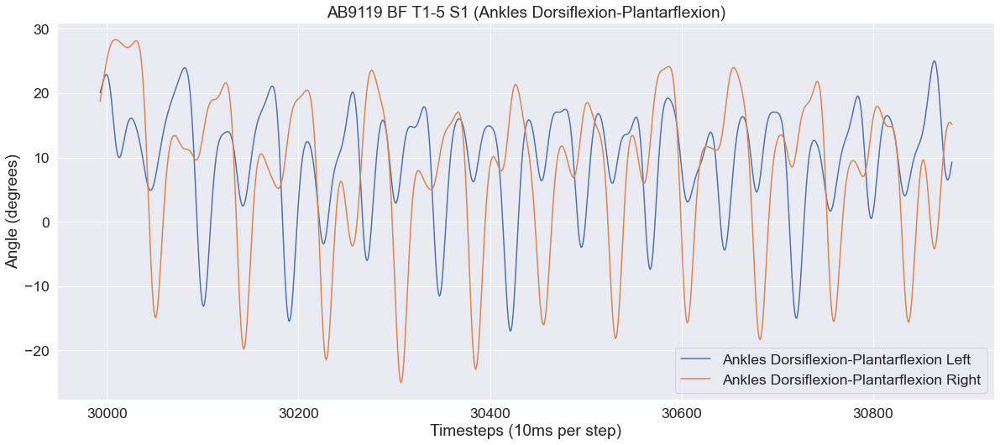

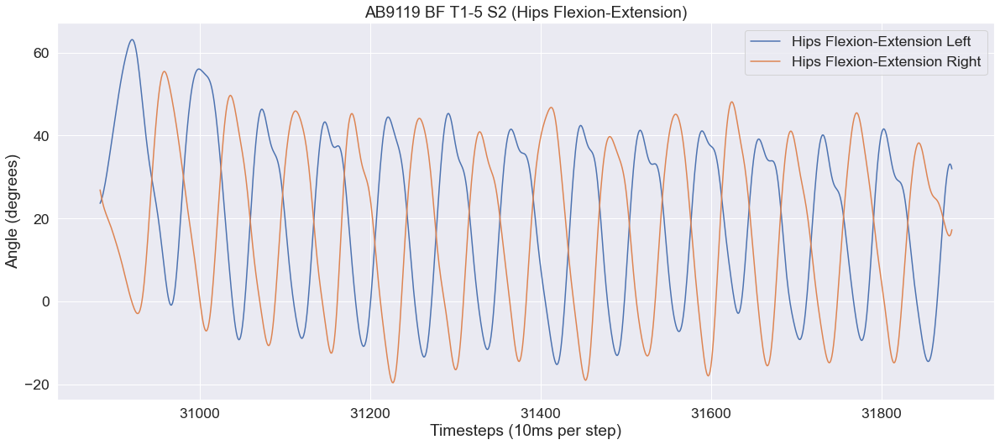

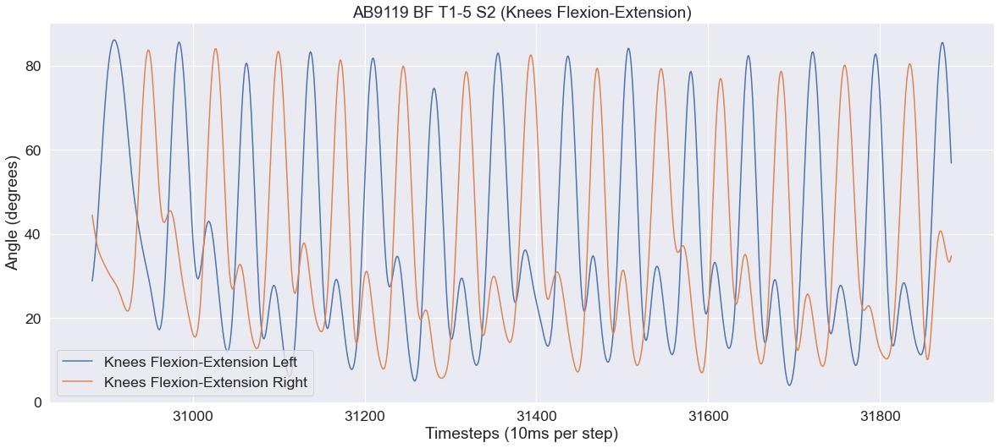

...

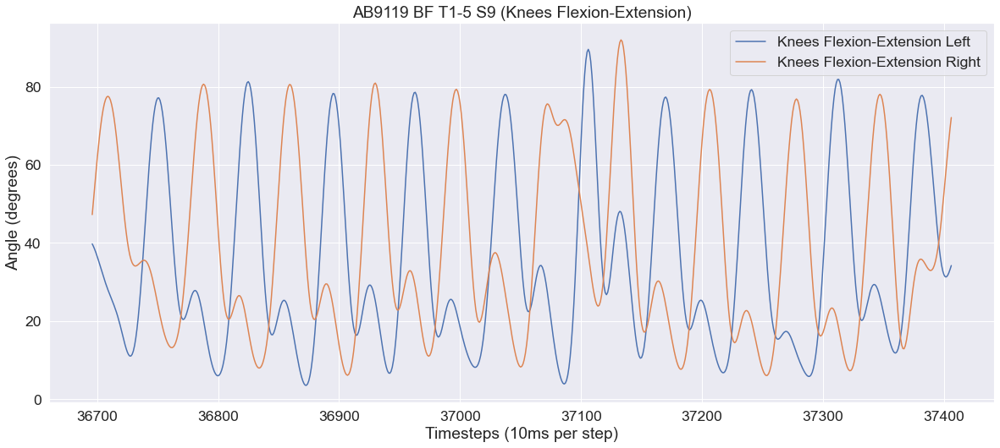

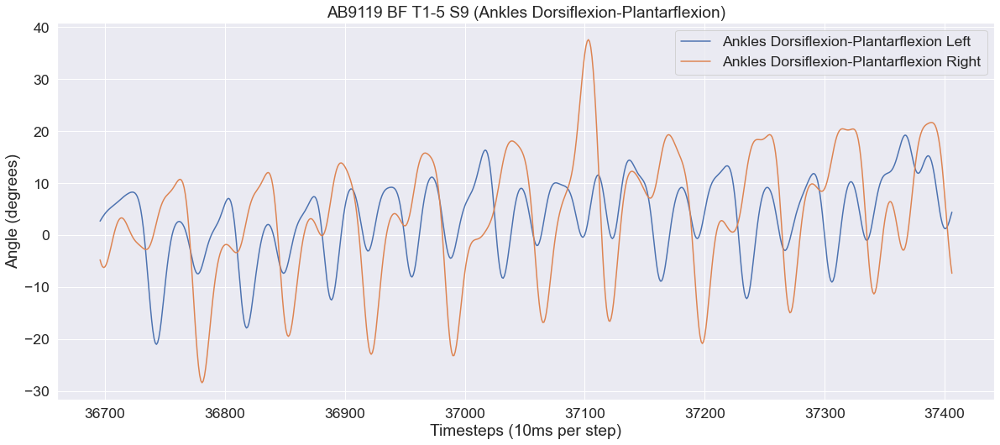

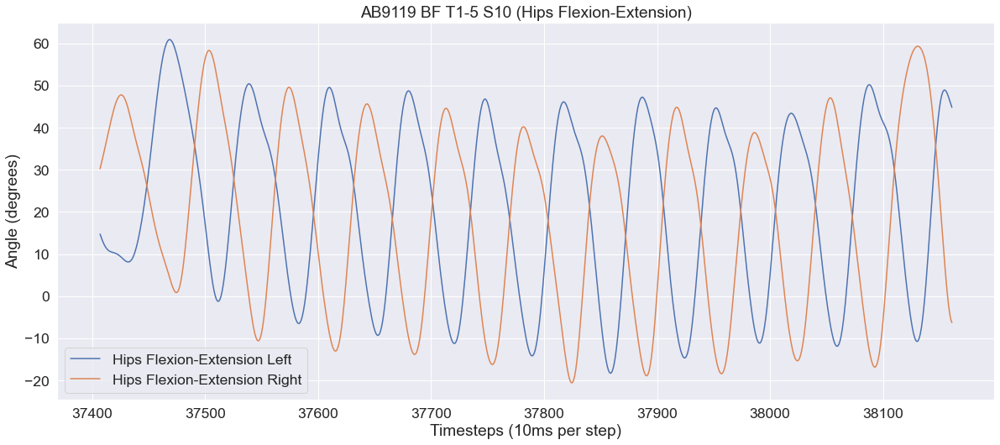

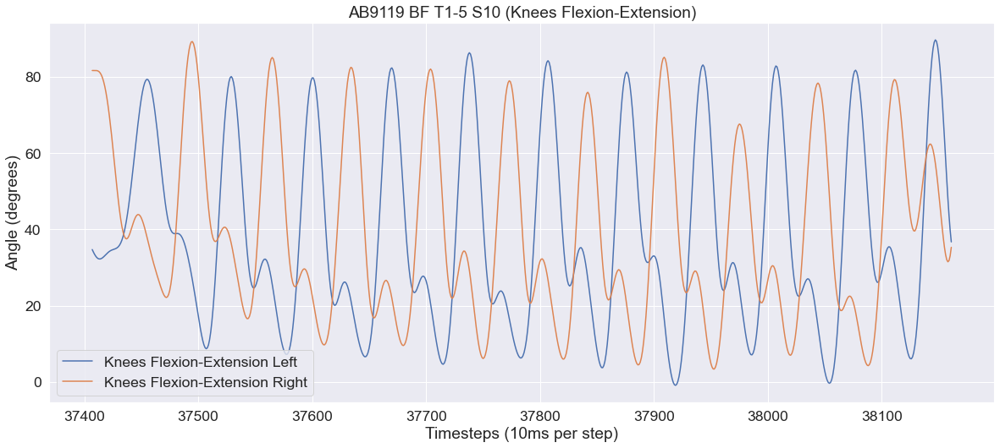

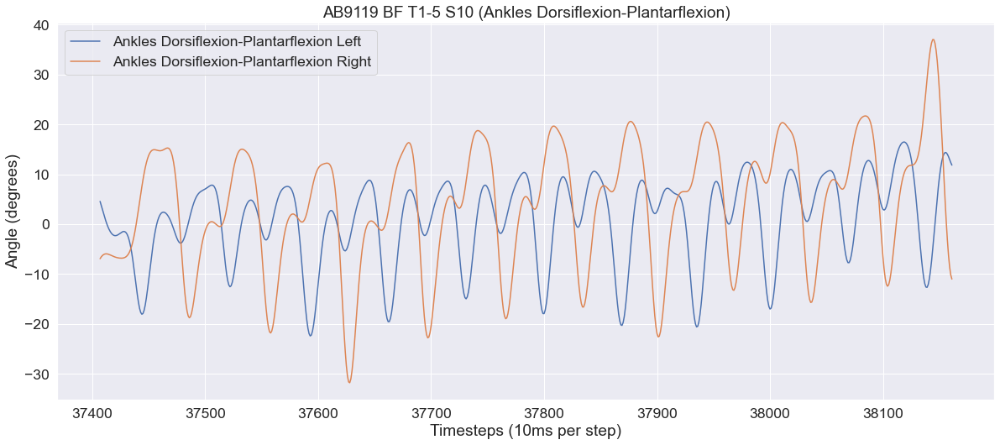

Timeseries is empty!
Trail 11 does not exist in AB9119 BF T1-5
Timeseries is empty!
Trail 12 does not exist in AB9119 BF T1-5
Timeseries is empty!
Trail 13 does not exist in AB9119 BF T1-5
Timeseries is empty!
Trail 14 does not exist in AB9119 BF T1-5
Timeseries is empty!
Trail 15 does not exist in AB9119 BF T1-5
Timeseries is empty!
Trail 16 does not exist in AB9119 BF T1-5


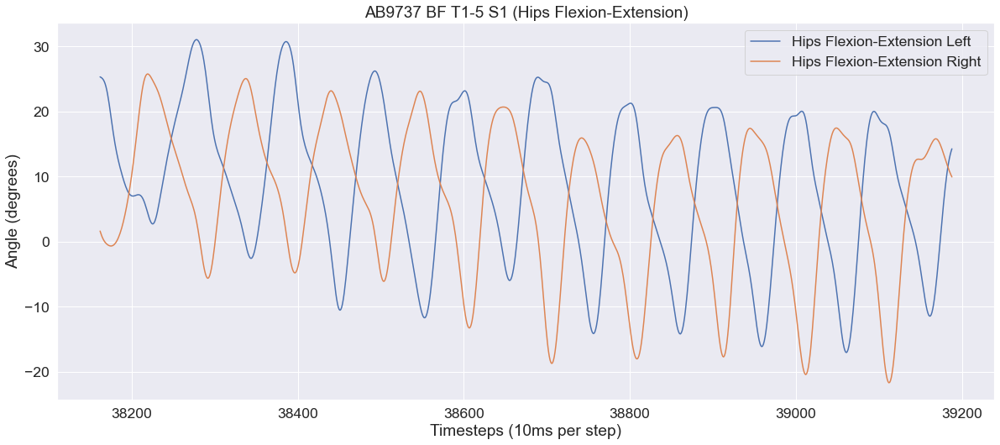

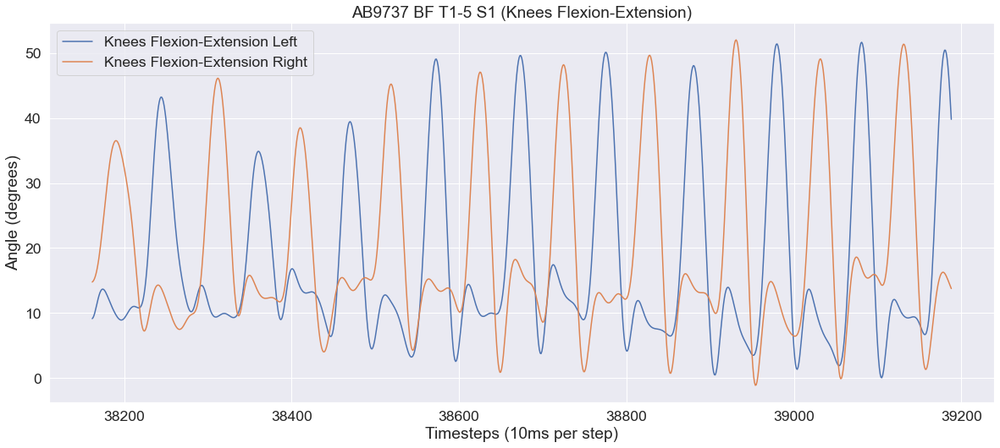

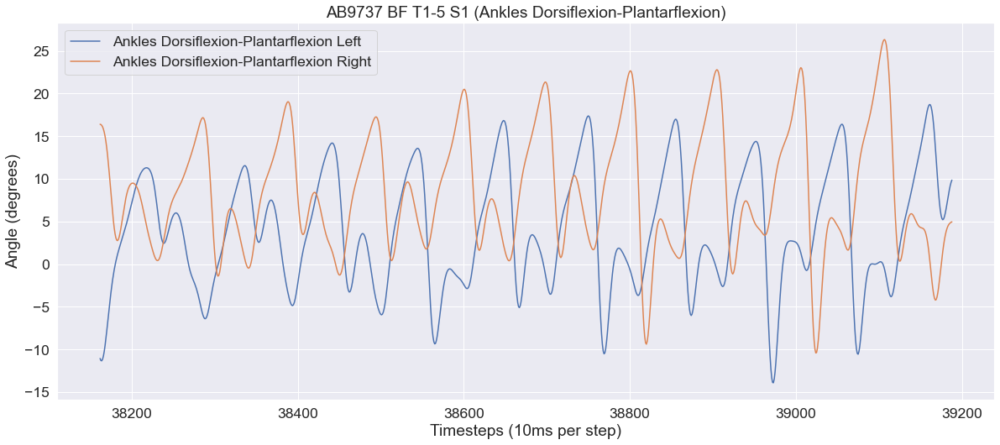

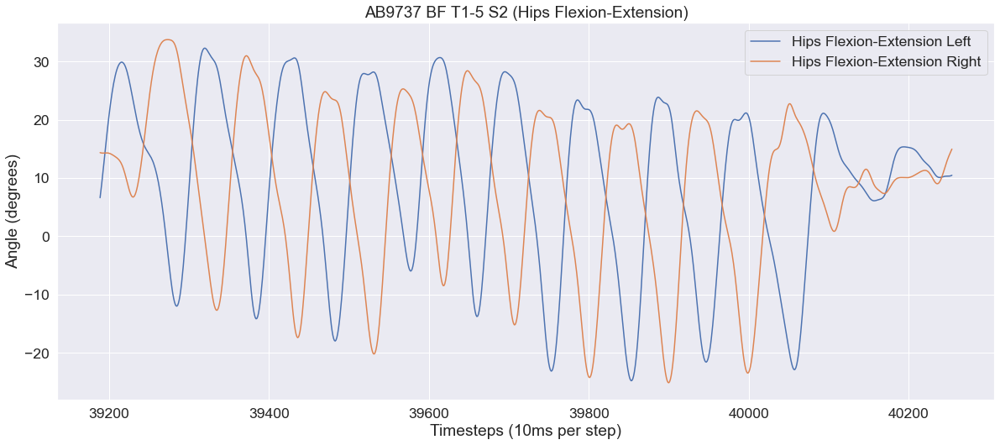

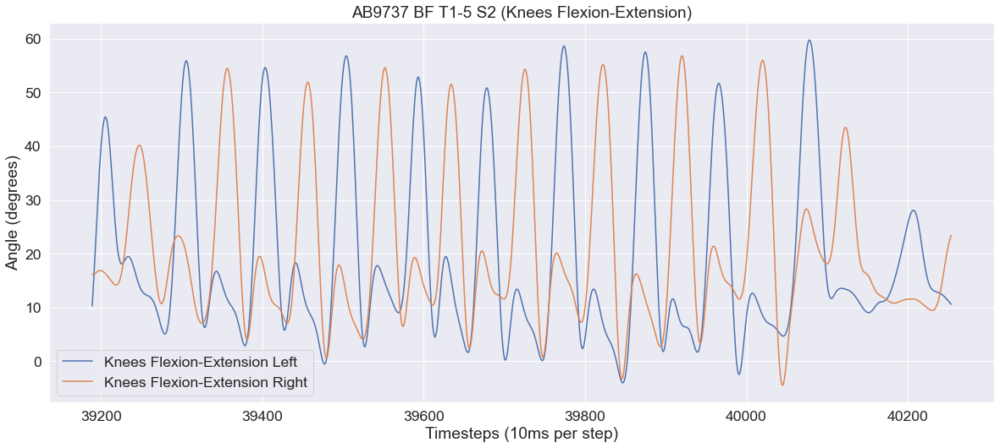

...

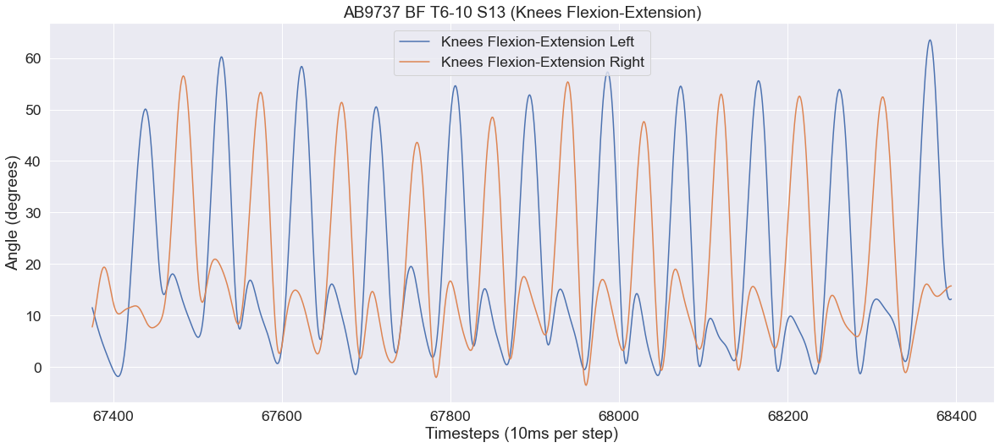

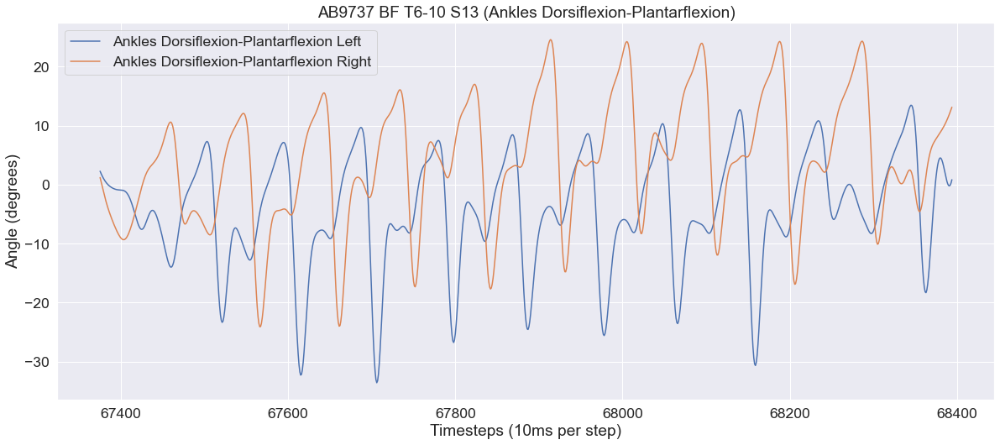

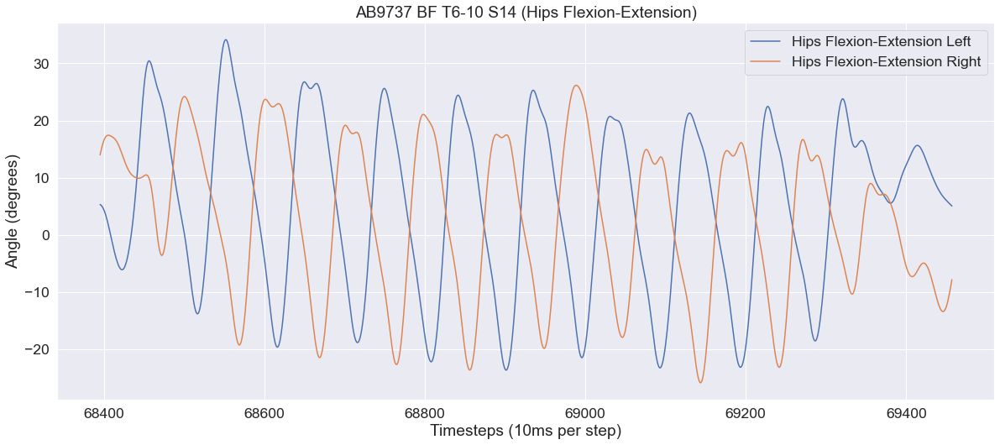

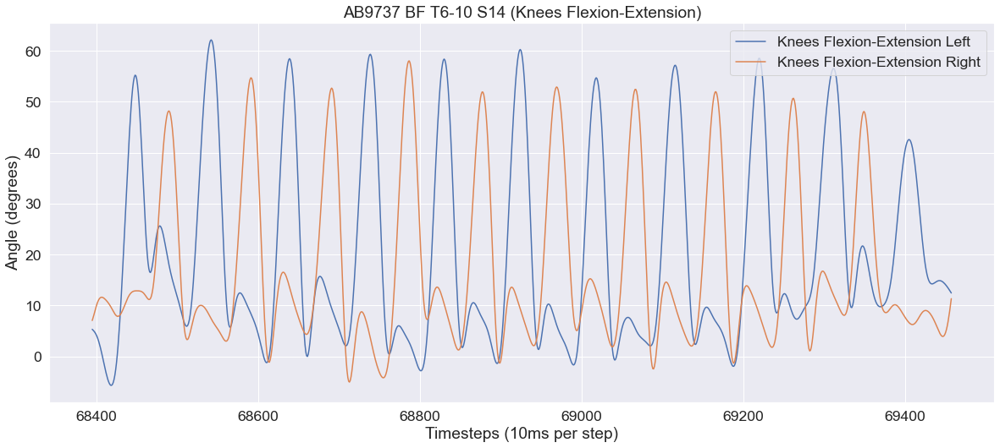

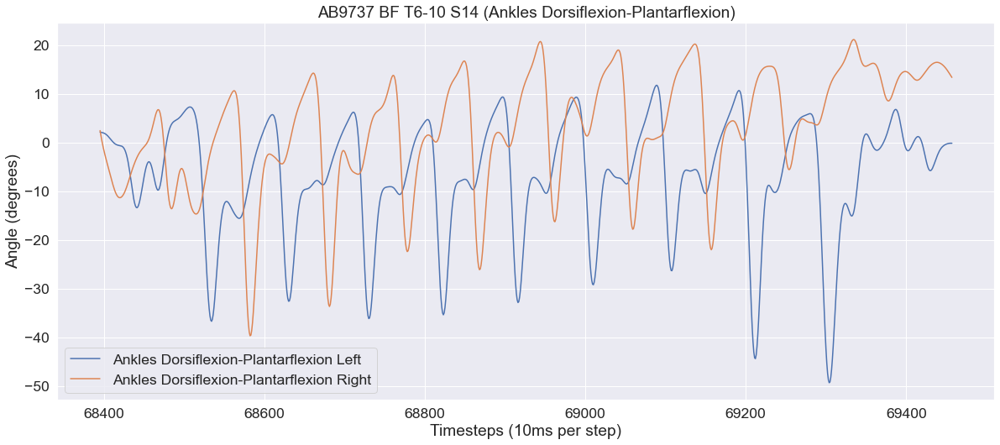

Timeseries is empty!
Trail 15 does not exist in AB9737 BF T6-10
Timeseries is empty!
Trail 16 does not exist in AB9737 BF T6-10


In [71]:
for p_ID in all_hlthy_subjects: #loop over healthy subjects

    for t_numb in range(1,n_trials+1): #loop over trials per subjec
    # p_ID = 'AB3154 BF T6-10' #patient ID
    # t_numb = 1 #trial number 
        timeseries = all_data[(all_data['Patient ID'] == p_ID) & (all_data['Trial'] == t_numb)]

        if timeseries.empty: #check if data exists in this file
            print('Timeseries is empty!')
            print(f'Trail {t_numb} does not exist in {p_ID}')
            
        else:
            sns.set()

            
            rcParams['figure.figsize'] = 20,8.27
            sns.set(font_scale = 1.6)

            for f in range(0,3):
                ttl = features[f][:-5] #plotting the title wthout left and right
                path = r'D:\Study 2 Data\Plots\Healthy Gait Train and Val' +  '\\' + p_ID + ' ' + 'S' + str(t_numb) + ' (' + ttl+ ')' + '.png'
                plt.plot(timeseries[features[f]], label = features[f])
                plt.plot(timeseries[features[f+3]], label=features[f+3])
                plt.title(p_ID + ' ' + 'S' + str(t_numb) + ' (' + ttl+ ')')
                plt.legend()
                plt.xlabel('Timesteps (10ms per step)')
                plt.ylabel('Angle (degrees)')
                plt.savefig(path)
                plt.show()



#### Divide into training and validation sets

In [ ]:
train_subjects = ['AB3154 BF T6-10', 
                     'AB6751 BF T1-5', 
                     'AB7779 BF T1-5',
                     'AB9737 BF T1-5', 
                     'AB9737 BF T6-10',
                     'AB7422 BF T1-5',
                     ]

val_subjects = ['AB9119 BF T1-5']

In [ ]:
train_data = all_data.loc[all_data['Patient ID'].isin(train_subjects)]

val_data = all_data.loc[all_data['Patient ID'].isin(val_subjects)]

In [ ]:
print(f'all_data: {all_data.shape}')
print(f'train_data: {train_data.shape}')
print(f'val_data: {val_data.shape}')

## Data Analysis

#### Data Analysis

In [ ]:
all_data.isnull().sum()

In [ ]:
# violin plot of the distribution (x,y,z for left leg)
from matplotlib import rcParams

rcParams['figure.figsize'] = 14,6
# 
sns.set_theme(style="whitegrid")

features_to_plt_left = ['Hips Flexion-Extension Left',
        'Hips Abduction-Adduction Left',
        'Hips Rotation Left',
        'Knees Flexion-Extension Left',
        'Knees Abduction-Adduction Left',
        'Knees Rotation Left',
        'Ankles Dorsiflexion-Plantarflexion Left',
        'Ankles Eversion-Inversion Left',
        'Ankles Rotation Left']

features_to_plt_right = ['Hips Flexion-Extension Right',
        'Hips Abduction-Adduction Right',
        'Hips Rotation Right',
        'Knees Flexion-Extension Right',
        'Knees Abduction-Adduction Right',
        'Knees Rotation Right',
        'Ankles Dorsiflexion-Plantarflexion Right',
        'Ankles Eversion-Inversion Right',
        'Ankles Rotation Right']

features_to_plt = zip(features_to_plt_left,features_to_plt_right)



for f in features_to_plt:

   
    ax= sns.violinplot(x="Patient ID", y=f[0], data=all_data, color="r", label='Left Leg')
    ax=sns.violinplot(x="Patient ID", y=f[1], data=all_data, color="b", label='Right Leg')
    
    ax.axes.set_title(f[1][:-5], fontsize=22)
    ax.set_xlabel("Patient ID",fontsize=20)
    ax.set_ylabel("Angle (degrees)",fontsize=20)
    ax.tick_params(labelsize=13)
    plt.legend(('Left Leg', 'Right Leg'), loc=1)


#     violinplot.set_alpha(0.25)
    plt.figure()

In [ ]:
# violin plot of the distribution (x,y,z for left right)
from matplotlib import rcParams

rcParams['figure.figsize'] = 14,6

sns.set(font_scale=3)
sns.set_theme(style="whitegrid")

features_to_plt = ['Hips Flexion-Extension Right',
        'Hips Abduction-Adduction Right',
        'Hips Rotation Right',
        'Knees Flexion-Extension Right',
        'Knees Abduction-Adduction Right',
        'Knees Rotation Right',
        'Ankles Dorsiflexion-Plantarflexion Right',
        'Ankles Eversion-Inversion Right',
        'Ankles Rotation Right']

for f in features_to_plt:
    ax = sns.violinplot(x="Patient ID", y=f,  data=all_data, palette="Spectral")
    ax.axes.set_title(f[:-5], fontsize=22)
    ax.set_xlabel("Patient ID",fontsize=20)
    ax.set_ylabel("Angle (degrees)",fontsize=20)
    ax.tick_params(labelsize=13)

    plt.figure()

In [ ]:
rcParams['figure.figsize'] = 12,8

sns.set_theme(style="darkgrid")
sns.set(font_scale=1.5)

features_to_plt = zip(features_to_plt_left,features_to_plt_right)

for f in features_to_plt:
    sns.histplot(all_data, x=f[0], color='teal', fill=True, kde=True, label='Left Leg')
    sns.histplot(all_data, x=f[1], color='gold', fill=True, kde=True, label='Right Leg')
    plt.legend()
    plt.show()

In [ ]:
# ax = sns.violinplot(x="Trial", y="Hips Flexion-Extension Left", 
#                     data=all_data[all_data['Patient ID'] == "AB3154 T6-10 BF"], palette="muted")

In [ ]:
# ax = sns.violinplot(x="Trial", y="Hips Flexion-Extension Left", 
#                     data=all_data[all_data['Patient ID'] == "AB5498 BF T6-10"], palette="muted")

## Data Processing

In [ ]:
train_samples = count_nsamples(train_data)
val_samples = count_nsamples(val_data)

In [ ]:
print(f'Number of train samples: {train_samples}')
print(f'Number of validation samples: {val_samples}')

In [ ]:
# all_data['Patient ID'] == "AB5498 BF T6-10" 

In [ ]:
# os.makedirs('D:\Study 2 Data\Pre-process sample', exist_ok=True)  #check if directory exists
# all_data.to_csv('D:\Study 2 Data\Pre-process sample/exported-data3.csv')  #export data to csv

#### Convert Data into numpy array for forming windows

In [ ]:
m = all_data['Patient ID'].unique()

In [ ]:

def pd_to_np_converter(data, n_samples, features):
    #create a numpy array that stores the data for export
    sample_ID = []
    # patients = 2
    # n_trials = 10
    # # samples = patients * n_trials
    data_store = np.zeros((n_samples, 2000, len(features)), dtype=np.float32)
    i = 0

    for p in data['Patient ID'].unique(): #loop over patients 
        for t in data['Trial'].unique(): #loop over trials starting with trials 1 to trial 9 (inclusive)
            pd_array = data[(data['Patient ID'] == p) & (data['Trial'] == t)]
            if pd_array.empty:
                continue
                # print('DataFrame is empty!')
                # print(f'Trail {t} does not exist in {p}')
            else:
                np_array = pd_array.to_numpy()
                data_store[i, :np_array.shape[0], :] = np_array[:,3:] 
                sample_ID.append(p+ ' Ts'+str(t)) 
                i +=1

    return pd_array.columns, data_store


In [ ]:
train_columns, train_data_np = pd_to_np_converter(train_data, train_samples, features)
val_columns, val_data_np = pd_to_np_converter(val_data, val_samples, features)

print(f'train_data_np.shape: {train_data_np.shape}')
print(f'val_data_np.shape: {val_data_np.shape}')

In [ ]:
train_columns[3:].tolist() 

In [ ]:
features == train_columns[3:].tolist() 

In [ ]:
labels_keys = train_columns[3:].tolist() #copy the train columns removing the first column headers'Patient ID', 'Trial', 'Time'


if features == labels_keys: # check that the features are the same as the label keys 
    print('YAY! Column headers of dataframe match features')
else:
    print('ERROR: Features and labels_keys do not match!')

#### Generate Dictionary for Features

In [ ]:
labels_keys = features 

labels_idx = np.arange(0, len(labels_keys), 1)

labels = dict(zip(labels_keys, labels_idx))

len(labels)
labels
# labels_keys

#### Process Data: Window Generation

In [ ]:
# Creating training datasets
# Selecting the features to be used when creating windows 
approx_seq_len = 2000 # appoximate the length of the longest sequence that can be encountered 
# samples_per_file = ((approx_seq_len - (input_window+output_window)) // stride) + 1 #number of window samples generated per file 
samples_per_file = 800


# create a zero-filled 3D array with shape (number of samples * number of files, window size, number of features)
X_train_windows = np.zeros((samples_per_file*train_samples, input_window, len(features)), dtype=np.float32) #size can be reduced by decreasing train_size 
Y_train_windows = np.zeros((samples_per_file*train_samples, output_window, len(features)), dtype=np.float32) 


start_idx = 0 #setting start index to equal zero 
train_sample_sum = 0
train_excluded_samples = []
# Create training windows 

#for i in tqdm(range(train_size)): #Use for including all data including outliers 
for i in range(train_samples): 
       
    X_values, Y_values = window_generator(
        train_data_np[i,:,:],
        input_window=input_window, 
        output_window=output_window, 
        stride=stride, 
        features=features,
        labels=labels
        )

    end_idx = start_idx + X_values.shape[0]

    # print(f'file number [{f}] start index: {start_idx}, end index: {end_idx}, number of samples: {X_values.shape[0]}')

    X_train_windows[start_idx:end_idx, :, :] = X_values
    Y_train_windows[start_idx:end_idx, :, :] = Y_values

    # print(f'number of samples copied: {X_train_data_store[start_idx:end_idx, :, :].shape[0]}')

    start_idx = end_idx 
    train_sample_sum += X_values.shape[0]

    # except Exception:
    #     exception_msg(i)
    #     train_excluded_samples.append(i)

# print(f"Completed storage of training windows samples, which contains {X_train_data_store.shape[0]} samples")
X_train_data = X_train_windows[:end_idx, :, :]
Y_train_data = Y_train_windows[:end_idx, :, :]


print(f'shape of X_train_windows: {X_train_windows.shape}')
print(f'shape of Y_train_windows: {Y_train_windows.shape}')

print(f'shape of X_train_data: {X_train_data.shape}')
print(f'shape of Y_train_data: {Y_train_data.shape}')

In [ ]:
# Creating validation datasets
# Selecting the features to be used when creating windows 
approx_seq_len = 2000 # appoximate the length of the longest sequence that can be encountered 
# samples_per_file = ((approx_seq_len - (input_window+output_window)) // stride) + 1 #number of window samples generated per file 
samples_per_file = 800


# create a zero-filled 3D array with shape (number of samples * number of files, window size, number of features)
X_val_windows = np.zeros((samples_per_file*val_samples, input_window, len(features)), dtype=np.float32) #size can be reduced by decreasing train_size 
Y_val_windows = np.zeros((samples_per_file*val_samples, output_window, len(features)), dtype=np.float32) 


start_idx = 0 #setting start index to equal zero 
val_sample_sum = 0
val_excluded_samples = []
# Create training windows 

#for i in tqdm(range(train_size)): #Use for including all data including outliers 
for i in range(val_samples): 
       
    X_values, Y_values = window_generator(
        val_data_np[i,:,:],
        input_window=input_window, 
        output_window=output_window, 
        stride=stride, 
        features=features,
        labels=labels
        )

    end_idx = start_idx + X_values.shape[0]

    # print(f'file number [{f}] start index: {start_idx}, end index: {end_idx}, number of samples: {X_values.shape[0]}')

    X_val_windows[start_idx:end_idx, :, :] = X_values
    Y_val_windows[start_idx:end_idx, :, :] = Y_values

    # print(f'number of samples copied: {X_train_data_store[start_idx:end_idx, :, :].shape[0]}')

    start_idx = end_idx 
    val_sample_sum += X_values.shape[0]

    # except Exception:
    #     exception_msg(i)
    #     train_excluded_samples.append(i)

# print(f"Completed storage of training windows samples, which contains {X_train_data_store.shape[0]} samples")
X_val_data = X_val_windows[:end_idx, :, :]
Y_val_data = Y_val_windows[:end_idx, :, :]


print(f'shape of X_val_windows: {X_val_windows.shape}')
print(f'shape of Y_val_windows: {Y_val_windows.shape}')

print(f'shape of X_val_data: {X_val_data.shape}')
print(f'shape of Y_val_data: {Y_val_data.shape}')

In [ ]:
Y_train_data.shape

In [ ]:
# # Plot histogram of the data 
# for f in range(len(features)):
#     plt.hist(Y_train_data[:,:,f].reshape(-1,1), label = features[f], bins=50, range=(Y_train_data.min(), Y_train_data.max()))
#     plt.legend()
#     plt.show()

rcParams['figure.figsize'] = 12,8

sns.set_theme(style="darkgrid")
sns.set(font_scale=1.5)

features_to_plt = zip(features_to_plt_left,features_to_plt_right)

for f in range(len(features)):
    sns.histplot(Y_train_data[:,:,f].reshape(-1,1), color='t', fill=True, kde=True, label=features[f])
    # sns.histplot(Y_train_data[:,:,f+1].reshape(-1,1), color='gold', fill=True, kde=True, label='Right Leg')
    plt.legend()
    plt.show()

#### Process Data: Normalisation/Standarisation

In [ ]:
X_train_norm, scalars = normalise_fit(X_train_data)
Y_train_norm = normalise_transform(Y_train_data, scalars)


X_val_norm = normalise_transform(X_val_data, scalars)
Y_val_norm = normalise_transform(Y_val_data, scalars)


scalars

In [ ]:
# rcParams['figure.figsize'] = 12,8

# sns.set_theme(style="darkgrid")
# sns.set(font_scale=1.5)

# features_to_plt = zip(features_to_plt_left,features_to_plt_right)

# for f in range(len(features)):
#     sns.histplot(X_train_norm[:,:,f].reshape(-1,1), color='t', fill=True, kde=True, label=features[f])
#     # sns.histplot(Y_train_data[:,:,f+1].reshape(-1,1), color='gold', fill=True, kde=True, label='Right Leg')
#     plt.legend()
#     plt.show()

In [ ]:
# Plot histogram of the data 
for f in range(len(features)):
    plt.hist(Y_train_norm[:,:,f].reshape(-1,1), bins=50, label = features[f])
    plt.legend()
    plt.show()

In [ ]:
# Convert to Tensor 
# do not store on GPU (yet)
X_train = torch.from_numpy(X_train_norm).float()
Y_train = torch.from_numpy(Y_train_norm).float()

X_val = torch.from_numpy(X_val_norm).float()
Y_val = torch.from_numpy(Y_val_norm).float()

print(f'X_train shape: {X_train.shape}')
print(f'Y_train shape: {Y_train.shape}')

print(f'X_val shape: {X_val.shape}')
print(f'Y_val shape: {Y_val.shape}')


In [ ]:
train_dataset = gaitDataset(X_train, Y_train)
# train_dataloader = DataLoader(train_dataset, batch_size=len(train_dataset), shuffle = False)
train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle = True)

val_dataset = gaitDataset(X_val, Y_val) #ADJUSTED
# val_dataloader = DataLoader(val_dataset, batch_size=len(val_dataset), shuffle=False)
val_dataloader = DataLoader(val_dataset, batch_size=32, shuffle=True)


print(f"Train Dataset length: {len(train_dataset)}")
print(f"Val Dataset length: {len(val_dataset)}")
